In [2]:
import floquet as ft
from floquet.model import CompositeModel
import numpy as np
import qutip as qt
import matplotlib.pyplot as plt
import scqubits as scq
from cycler import cycler
from itertools import islice

In [29]:
color_cycler = cycler(plt.rcParams["axes.prop_cycle"])
ls_cycler = cycler(ls=["-", "--", "-.", ":"])
alpha_cycler = cycler(alpha=[1.0, 0.6, 0.2])
color_ls_alpha_cycler = alpha_cycler * ls_cycler * color_cycler
# first initialize the qubits + sim params
dim_q = 30
state_indices = [0, 1]

omega_d_single_A = 2*np.pi*5.095
omega_d_single_C = 2*np.pi*7.327

options = ft.Options(
    num_cpus=3,
    fit_range_fraction=0.6,
    floquet_sampling_time_fraction=0.0,
    nsteps=10000,
    fit_cutoff=4,
    overlap_cutoff=0.8,
    save_floquet_modes=True,
)

class makequbit:
    def __init__(self, name, EJ, EC, EL, flux=0.5, cutoff=110, 
                 omega_d_array=None, use_band=False):
        self.name = name
        self.params = dict(EJ=EJ, EC=EC, EL=EL, flux=flux, cutoff=cutoff)
        self.omega_d_array = np.atleast_1d(omega_d_array)
        self.use_band = bool(use_band)

qA = makequbit(
    name='A',
    EJ=4.167, EC=0.8308, EL=1.203, flux=0.5, cutoff=200,
    omega_d_array=np.array([omega_d_single_A]),
    use_band=False
)

qC = makequbit(
    name="C",
    EJ=3.6996, EC=0.8394, EL=1.0376, flux=0.5, cutoff=110,
    omega_d_array=np.array([omega_d_single_C]),
    use_band=False
)

def compute_chi_shift(flux, qubit_params, dim_q, omega_r, g, state_idx=0):
    params = dict(qubit_params)
    params['flux'] = float(flux)
    fluxonium = scq.Fluxonium(**params, truncated_dim=dim_q)
    evals = 2 * np.pi * fluxonium.eigenvals(evals_count=dim_q)
    n_mat = fluxonium.matrixelement_table('n_operator', evals_count=dim_q)
    chi = 0.0
    for j in range(dim_q):
        if j == state_idx:
            continue
        omega_ij = evals[j] - evals[state_idx]
        g_ij = g * np.abs(n_mat[state_idx, j])
        if np.abs(omega_ij - omega_r) > 1e-6:  #account for near-resonant terms
            chi += g_ij**2 / (omega_ij - omega_r)
    return chi

def flux_sweep_dressed_resonator(qubit, flux_grid, chi_grid, omega_r_bare,
                                  plot_state_idx=1, 
                                  dim_q=dim_q, state_indices_list=state_indices,
                                  operator_name='n'):
    print(f"Flux sweep for {qubit.name}, tracking state {plot_state_idx}...")
    print(f"Flux range: [{flux_grid.min():.4f}, {flux_grid.max():.4f}]")
    print(f"Bare resonator: {omega_r_bare/(2*np.pi):.4f} GHz")
    
    scar = np.zeros((len(flux_grid), len(chi_grid)), dtype=float)
    omega_d_used = np.zeros(len(flux_grid))
    
    for i, flx in enumerate(flux_grid):
        #compute dressed resonator frequency at this flux
        flx = float(flx)
        chi_shift = compute_chi_shift(flx, qubit.params, dim_q, qubit.omega_d_array[0], g=0.026*2*np.pi, state_idx=plot_state_idx)
        omega_d = omega_r_bare + chi_shift
        omega_d_used[i] = omega_d
        
        H0, H1 = get_H0_H1_for_flux(flx, qubit.params, dim_q, operator_name=operator_name)
        data = run_floquet(H0, H1, omega_d_array=np.array([omega_d]), chi_array=chi_grid, 
                          state_indices=state_indices_list)
        ovlp = np.asarray(data['displaced_state_overlaps'])
        col = ovlp[0, :, plot_state_idx]
        scar[i, :] = np.clip(1.0 - np.abs(col) ** 2, 0.0, 0.5)
    
    print(f"Drive freq range: [{omega_d_used.min()/(2*np.pi):.4f}, {omega_d_used.max()/(2*np.pi):.4f}] GHz")
    print("Flux sweep complete!\n")
    
    fig, ax = plt.subplots(figsize=(8, 4))
    im = ax.imshow(
        scar.T, origin="lower", cmap="Blues", aspect="auto",
        extent=[flux_grid.min(), flux_grid.max(),
                chi_grid.min()/(2*np.pi), chi_grid.max()/(2*np.pi)],
        interpolation="none",
    )
    ax.set_xlabel("Flux", fontsize=12)
    ax.set_ylabel(r"$\chi_{\rm ac}$ [GHz]", fontsize=12)
    ax.set_title(f"{qubit.name}, State {plot_state_idx}: $\omega_d = \omega_r + \chi(\\phi)$", fontsize=11)
    cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label(r"$1-|\langle \mathrm{disp}|\mathrm{Floquet}\rangle|^2$", fontsize=11)
    plt.tight_layout()
    plt.show()
    
    return scar, flux_grid, chi_grid, omega_d_used, data

def get_H0_H1_for_flux(flux_value: float, qubit_params: dict, dim_q: int, operator_name:str= 'n'):
    """construct drift+drive hamiltonians for a given flux value."""
    qparams = dict(qubit_params)
    qparams['flux'] = float(flux_value)
    fluxonium = scq.Fluxonium(**qparams, truncated_dim=dim_q)
    hilbert_space = scq.HilbertSpace([fluxonium])
    hilbert_space.generate_lookup()

    evals = hilbert_space['evals'][0][:dim_q]
    H0 = 2*np.pi*qt.Qobj(np.diag(evals)) #radians
    if operator_name == 'n':
        H1 = hilbert_space.op_in_dressed_eigenbasis(fluxonium.n_operator)
    if operator_name == 'phi':
        H1 = hilbert_space.op_in_dressed_eigenbasis(fluxonium.phi_operator)
    return H0, H1

def run_floquet(H0, H1, omega_d_array, chi_array, state_indices):
    """run Floquet analysis"""
    chi_to_amp = ft.ChiacToAmp(H0, H1, state_indices, omega_d_array)
    drive_amps = chi_to_amp.amplitudes_for_omega_d(chi_array)
    model = ft.Model(H0, H1, omega_d_values=omega_d_array, drive_amplitudes=drive_amps)
    return ft.FloquetAnalysis(model, state_indices=state_indices, options=options).run(filepath=None)


def flux_sweep(qubit, flux_grid, chi_grid, omega_d_single, 
               plot_state_idx=1, dim_q=dim_q, state_indices_list=state_indices, chi_shift = True, 
               operator_name='n'):
    """
    run flux sweep and plot scar map. this will run floquet for every flux point defined in given range.
    
    returns:
    scar map + flux and chi values
    """
    print(f"flux sweep for {qubit.name}, tracking state {plot_state_idx}...")
    print(f"Flux range: [{flux_grid.min():.4f}, {flux_grid.max():.4f}]")
    print(f"Chi range: [0, {chi_grid.max()/(2*np.pi):.4f}] GHz")
    print(f" size: {len(flux_grid)} x {len(chi_grid)}")
    omega_arr = np.array([omega_d_single], dtype=float)
    scar = np.zeros((len(flux_grid), len(chi_grid)), dtype=float)
    for i, flx in enumerate(flux_grid):
        H0, H1 = get_H0_H1_for_flux(flx, qubit.params, dim_q, operator_name=operator_name)
        data = run_floquet(H0, H1, omega_d_array=omega_arr, chi_array=chi_grid, 
                          state_indices=state_indices_list)
        ovlp = np.asarray(data['displaced_state_overlaps'])
        col = ovlp[0, :, plot_state_idx]
        scar[i, :] = np.clip(1.0 - np.abs(col) ** 2, 0.0, 0.5)
    print("flux sweep complete!\n")
    #now plot the results!
    fig, ax = plt.subplots(figsize=(8, 4))
    im = ax.imshow(
        scar.T,
        origin="lower",
        cmap="Blues",
        aspect="auto",
        extent=[flux_grid.min(), flux_grid.max(),
                chi_grid.min()/(2*np.pi), chi_grid.max()/(2*np.pi)],
        interpolation="none",
    )
    
    ax.set_xlabel("Flux", fontsize=12)
    ax.set_ylabel(r"$\chi_{\rm ac}$ [GHz]", fontsize=12)
    ax.set_title(f"{qubit.name}, State {plot_state_idx}: $\omega_d/2\pi$ = {omega_d_single/(2*np.pi):.3f} GHz, Operator: {operator_name}", 
                fontsize=11)
    cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label(r"$1-|\langle \mathrm{disp}|\mathrm{Floquet}\rangle|^2$", fontsize=11)
    plt.tight_layout()
    plt.show()
    return scar, flux_grid, chi_grid, data


def drive_sweep(qubit, flux, chi_grid, omega_d_vals, 
               plot_state_idx=1, dim_q=dim_q, state_indices_list=state_indices,
               operator_name='n'):
    """
    run drive sweep and plot scar map. this will run floquet for every frequency defined in given range.
    
    returns:
    scar map + flux and chi values
    """

    omega_d_vals = np.asarray(omega_d_vals, dtype=float)

    scar = np.zeros((len(omega_d_vals), len(chi_grid)), dtype=float)

    for i, freq in enumerate(omega_d_vals):
        H0, H1 = get_H0_H1_for_flux(flux, qubit.params, dim_q, operator_name=operator_name)
        data = run_floquet(H0, H1, omega_d_array=np.array([freq]), chi_array=chi_grid, 
                          state_indices=state_indices_list)
        ovlp = np.asarray(data['displaced_state_overlaps'])
        col = ovlp[0, :, plot_state_idx]
        scar[i, :] = np.clip(1.0 - np.abs(col) ** 2, 0.0, 0.5)

    
    print("drive sweep complete!\n")

    #now plot the results!
    fig, ax = plt.subplots(figsize=(8, 4))
    im = ax.imshow(
        scar.T,
        origin="lower",
        cmap="Blues",
        aspect="auto",
        extent=[omega_d_vals.min()/(2*np.pi), omega_d_vals.max()/(2*np.pi),
                chi_grid.min()/(2*np.pi), chi_grid.max()/(2*np.pi)],
        interpolation="none",
    )
    
    ax.set_xlabel(r"$\omega_d/2\pi$ [GHz]", fontsize=12)
    ax.set_ylabel(r"$\chi_{\rm ac}$ [GHz]", fontsize=12)
    ax.set_title(f"{qubit.name}, State {plot_state_idx}: $flux$ = {flux:.3f} GHz, Operator: {operator_name}", 
                fontsize=11)
    cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label(r"$1-|\langle \mathrm{disp}|\mathrm{Floquet}\rangle|^2$", fontsize=11)
    plt.tight_layout()
    plt.show()
    return scar, omega_d_vals, chi_grid, data

def plot_flux_sweep(scar, flux_grid, chi_grid, qubit_name='', omega_d=None, state_idx=1):
    """
    helper funtion to plot flux sweep scar map.
    """
    fig, ax = plt.subplots(figsize=(8, 4))
    im = ax.imshow(
        scar.T,
        origin="lower",
        cmap="Blues",
        aspect="auto",
        extent=[flux_grid.min(), flux_grid.max(),
                chi_grid.min()/(2*np.pi), chi_grid.max()/(2*np.pi)],
        interpolation="none",
    )
    
    ax.set_xlabel("Flux", fontsize=12)
    ax.set_ylabel(r"$\chi_{\rm ac}$ [GHz]", fontsize=12)
    
    title = f"{qubit_name}, State {state_idx}"
    if omega_d is not None:
        title += f": $\omega_d/2\pi$ = {omega_d/(2*np.pi):.3f} GHz"
    ax.set_title(title, fontsize=11)
    
    cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label(r"$1-|\langle \mathrm{disp}|\mathrm{Floquet}\rangle|^2$", fontsize=11)
    
    plt.tight_layout()
    plt.show()

def plot_drive_sweep(scar, omega_d_vals, chi_grid, qubit_name='', flux=None, state_idx=1):
    """
    helper funtion to plot drive sweep scar map.
    """
    fig, ax = plt.subplots(figsize=(8, 4))
    im = ax.imshow(
        scar.T,
        origin="lower",
        cmap="Blues",
        aspect="auto",
        extent=[omega_d_vals.min()/(2*np.pi), omega_d_vals.max()/(2*np.pi),
                chi_grid.min()/(2*np.pi), chi_grid.max()/(2*np.pi)],
        interpolation="none",
    )
    
    ax.set_xlabel(r"$\omega_d/2\pi$ [GHz]", fontsize=12)
    ax.set_ylabel(r"$\chi_{\rm ac}$ [GHz]", fontsize=12)
    
    title = f"{qubit_name}, State {state_idx}"
    if flux is not None:
        title += f": $flux$ = {flux:.3f}"
    ax.set_title(title, fontsize=11)
    
    cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label(r"$1-|\langle \mathrm{disp}|\mathrm{Floquet}\rangle|^2$", fontsize=11)
    
    plt.tight_layout()
    plt.show()

def mark_flux_on_map(scar, flux_grid, chi_grid, flux_points, 
                     qubit_name='', omega_d=None, state_idx=1):
    """
    helper funtion to identify flux points where there is a lot of hybridization/wacky behavior.
    """
    fig, ax = plt.subplots(figsize=(8, 4))
    im = ax.imshow(
        scar.T,
        origin="lower",
        cmap="Blues",
        aspect="auto",
        extent=[flux_grid.min(), flux_grid.max(),
                chi_grid.min()/(2*np.pi), chi_grid.max()/(2*np.pi)],
        interpolation="none",
    )
    if flux_points is not None:
        flux_points = np.atleast_1d(flux_points)
        for flux_val in flux_points:
            ax.axvline(flux_val, color='red', linestyle='--', linewidth=2, alpha=0.8)
            ax.text(flux_val, chi_grid.max()/(2*np.pi)*0.95, 
                f'flux={flux_val:.4f}',
                rotation=90, va='top', ha='right', color='red', fontsize=9,
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.7))
    
    ax.set_xlabel("Flux", fontsize=12)
    ax.set_ylabel(r"$\chi_{\rm ac}$ [GHz]", fontsize=12)
    
    title = f"{qubit_name}, State {state_idx}"
    if omega_d is not None:
        title += f": $\omega_d/2\pi$ = {omega_d/(2*np.pi):.3f} GHz"
    ax.set_title(title, fontsize=11)
    
    cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label(r"$1-|\langle \mathrm{disp}|\mathrm{Floquet}\rangle|^2$", fontsize=11)
    
    plt.tight_layout()
    plt.show()

def compute_branch_analysis(qubit, flux_point, chi_grid, omega_d_single,
                            dim_q=dim_q, state_indices_list=state_indices):
    """
    compute branch analysis for a single flux point.
    """
    print(f"\nComputing branch analysis at flux = {flux_point:.4f}")
    print(f"Qubit: {qubit.name}")
    print(f"Drive frequency: {omega_d_single/(2*np.pi):.3f} GHz")
    
    omega_arr = np.array([omega_d_single], dtype=float)
    H0, H1 = get_H0_H1_for_flux(flux_point, qubit.params, dim_q)
    results = run_floquet(H0, H1, omega_d_array=omega_arr, chi_array=chi_grid,
                         state_indices=state_indices_list)
    
    print("branch analysis complete!\n")
    
    #now store all our data
    results['_metadata'] = {
        'flux_point': flux_point,
        'qubit_name': qubit.name,
        'omega_d': omega_d_single,
        'chi_grid': chi_grid
    }
    
    return results

def plot_branch_analysis(results, chi_grid=None, flux_point=None,
                         qubit_name=None, omega_d=None,
                         max_curves=20, highlight_states=None,
                         plot_quantity='avg_excitation',
                         figsize=(7, 4), show_grid=True,
                         gray_others=True,
                         ylim = None):
    """
    plot our branch analysis results (after compute_branch_analysis)
    """
    # get the data from pre-computed results
    if '_metadata' in results:
        meta = results['_metadata']
        chi_grid = chi_grid if chi_grid is not None else meta.get('chi_grid')
        flux_point = flux_point if flux_point is not None else meta.get('flux_point')
        qubit_name = qubit_name if qubit_name is not None else meta.get('qubit_name')
        omega_d = omega_d if omega_d is not None else meta.get('omega_d')
    
    data = results[plot_quantity][0, :, :max_curves]
    
    fig, ax = plt.subplots(figsize=figsize)
    
    from itertools import islice
    
    #this will color only a few specified branches and gray out the rest (gray_others = True and highlight_states is not None)
    if gray_others and highlight_states is not None and len(highlight_states) > 0:
        #plot all non-highlighted states in gray
        for curve_idx in range(data.shape[1]):
            if curve_idx not in highlight_states:
                y = data[:, curve_idx]
                ax.plot(chi_grid/(2*np.pi), y, 
                       color='gray', alpha=0.3, linewidth=1,
                       label=str(curve_idx) if curve_idx < 10 else None)
        
        #plot highlighted states with colors
        color_iter = islice(color_ls_alpha_cycler, len(highlight_states))
        for curve_idx, sty in zip(sorted(highlight_states), color_iter):
            if curve_idx < data.shape[1]:
                y = data[:, curve_idx]
                ax.plot(chi_grid/(2*np.pi), y, label=str(curve_idx), 
                       linewidth=1.5, **sty)
    else:
        #this will plot all branches in color
        for curve_idx, (y, sty) in enumerate(
            zip(data.T, islice(color_ls_alpha_cycler, data.shape[1])), 
            start=0
        ):
            #if you change linewidth and still have highlight_states not None, then the highlighted states specified will appear to be bolder (thicker line)
            if highlight_states and curve_idx in highlight_states:
                ax.plot(chi_grid/(2*np.pi), y, label=str(curve_idx), 
                       linewidth=1.5, **sty)
            else:
                ax.plot(chi_grid/(2*np.pi), y, label=str(curve_idx), **sty)
    
    if plot_quantity == 'avg_excitation':
        ylabel = r"$N_{q}$"
    elif plot_quantity == 'displaced_state_overlaps':
        ylabel = r"$|\langle \mathrm{disp}|\mathrm{Floquet}\rangle|^2$"
    else:
        ylabel = plot_quantity
    
    ax.set_ylabel(ylabel, fontsize=12)
    if ylim is not None:
        ax.set_ylim(ylim[0], ylim[1])
    ax.set_xlabel(r"$\chi_{\rm ac}$ [GHz]", fontsize=12)
    ax.legend(fontsize=10, ncol=2, loc="upper left", bbox_to_anchor=(1, 1))
    
    
    title_parts = []
    if qubit_name:
        title_parts.append(f"q{qubit_name}")
    if flux_point is not None:
        title_parts.append(f"flux={flux_point:.4f}")
    if omega_d is not None:
        title_parts.append(f"$\omega_d/2\pi$={omega_d/(2*np.pi):.3f} GHz")
    
    if title_parts:
        ax.set_title(", ".join(title_parts), fontsize=11)
    
    if show_grid:
        ax.grid(alpha=0.3, linestyle='--', linewidth=0.5)
    
    plt.tight_layout()
    plt.show()
    
    return fig, ax

Running floquet simulation with parameters: 
model: H0: Quantum object: dims=[[40], [40]], shape=(40, 40), type='oper', dtype=Dense, isherm=True
Qobj data =
[[ 13.78915505   0.           0.         ...   0.           0.
    0.        ]
 [  0.          17.22582644   0.         ...   0.           0.
    0.        ]
 [  0.           0.          35.80425936 ...   0.           0.
    0.        ]
 ...
 [  0.           0.           0.         ... 626.8470332    0.
    0.        ]
 [  0.           0.           0.         ...   0.         642.86941965
    0.        ]
 [  0.           0.           0.         ...   0.           0.
  658.72763086]]
H1: Quantum object: dims=[[40], [40]], shape=(40, 40), type='oper', dtype=CSR, isherm=True
Qobj data =
[[0.+0.00000000e+00j 0.+1.66691364e-01j 0.+0.00000000e+00j ...
  0.-7.69474597e-09j 0.+0.00000000e+00j 0.+4.15518753e-09j]
 [0.-1.66691364e-01j 0.+0.00000000e+00j 0.+5.94213490e-01j ...
  0.+0.00000000e+00j 0.-1.59976871e-09j 0.+0.00000000e+00j]
 [0.+0

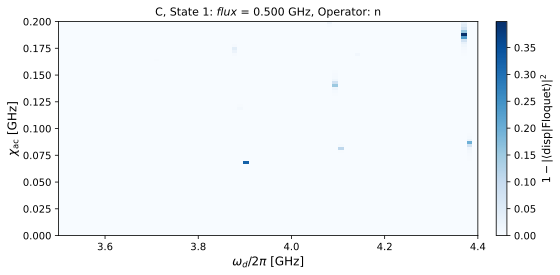

In [4]:
drive_vals = 2*np.pi * np.linspace(3.5, 4.4, 75)
chi_ac_vals = 2*np.pi * np.linspace(0, 0.2, 75)

scar_nC, drive_grid, chi_grid, data_nC = drive_sweep(
    qC,
    flux=0.5,
    chi_grid=chi_ac_vals,
    omega_d_vals=drive_vals,
    plot_state_idx=1,
    operator_name='n'
)



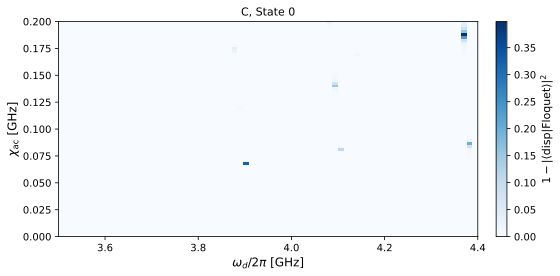

In [10]:
plot_drive_sweep(scar_nC, omega_d_vals=drive_vals, chi_grid=chi_grid, qubit_name='C', state_idx=0)

In [ ]:
scar_phiC, drive_grid, chi_grid, data_phiC = drive_sweep(
    qC,
    flux=0.5,
    chi_grid=chi_ac_vals,
    omega_d_vals=drive_vals,
    plot_state_idx=1,
    operator_name='phi'
)

flux sweep for A, tracking state 1...
Flux range: [0.0100, 0.6000]
Chi range: [0, 0.2000] GHz
 size: 401 x 401
Running floquet simulation with parameters: 
model: H0: Quantum object: dims=[[30], [30]], shape=(30, 30), type='oper', dtype=Dense, isherm=True
Qobj data =
[[ -8.45120146   0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.        ]
 [  0.          24.64851969   0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.        ]
 [  0.

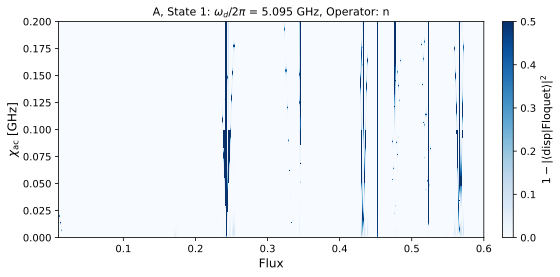

Flux sweep for A, tracking state 1...
Flux range: [0.0100, 0.6000]
Bare resonator: 5.0950 GHz


TypeError: compute_chi_shift() missing 2 required positional arguments: 'omega_r' and 'g'

In [28]:
chi_ac_vals = 2*np.pi * np.linspace(0, 0.2, 401)
flux_vals = np.linspace(0.01, 0.6, 401)

scar_bare, flx_grid, chi_grid, data_bare = flux_sweep(
    qA, flux_grid=flux_vals, chi_grid=chi_ac_vals, omega_d_single=omega_d_single_A,
    plot_state_idx=1, operator_name='n')

scar_dressed, flx_grid, chi_grid, data_dressed = flux_sweep_dressed_resonator(
    qA, flux_grid=flux_vals, chi_grid=chi_ac_vals, omega_r_bare=omega_d_single_A,
    plot_state_idx=1)


In [ ]:
scar_dressed, flx_grid, chi_grid, data_dressed = flux_sweep_dressed_resonator(
    qA, flux_grid=flux_vals, chi_grid=chi_ac_vals, omega_r_bare=omega_d_single_A,
    plot_state_idx=1)


Flux sweep for A, tracking state 1...
Flux range: [0.0100, 0.6000]
Bare resonator: 5.0950 GHz
Running floquet simulation with parameters: 
model: H0: Quantum object: dims=[[30], [30]], shape=(30, 30), type='oper', dtype=Dense, isherm=True
Qobj data =
[[ -8.45120146   0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.        ]
 [  0.          24.64851969   0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.        ]
 [  0.           0.    

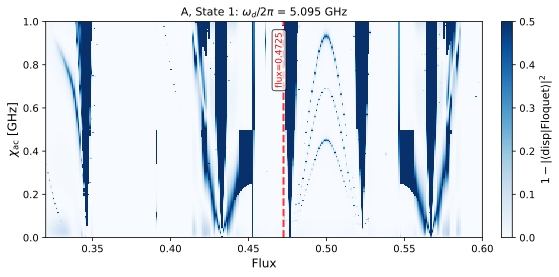

In [32]:
mark_flux_on_map(scar, flux_grid, chi_grid, 0.4725
                 ,
                     qubit_name=qA.name, omega_d=omega_d_single_A, state_idx=1)

In [33]:
results = compute_branch_analysis(qA, 
                                  flux_point= 0.5,
                                  chi_grid=chi_ac_vals,
                                  omega_d_single=omega_d_single_A)


Computing branch analysis at flux = 0.5000
Qubit: A
Drive frequency: 5.095 GHz
Running floquet simulation with parameters: 
model: H0: Quantum object: dims=[[30], [30]], shape=(30, 30), type='oper', dtype=Dense, isherm=True
Qobj data =
[[ 15.49605443   0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.        ]
 [  0.          18.77831684   0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.
    0.           0.           0.           0.           0.        ]
 [  0.           0.          38.38617

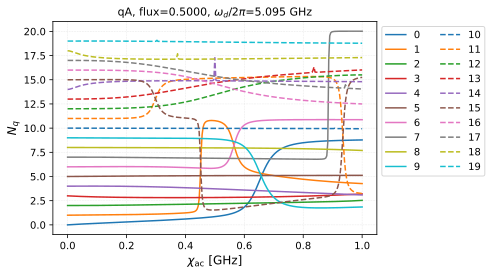

(<Figure size 700x400 with 1 Axes>,
 <Axes: title={'center': 'qA, flux=0.5000, $\\omega_d/2\\pi$=5.095 GHz'}, xlabel='$\\chi_{\\rm ac}$ [GHz]', ylabel='$N_{q}$'>)

In [35]:
plot_branch_analysis(results, max_curves=20, highlight_states=None, plot_quantity="avg_excitation", gray_others=True)

---------------------------------------------------------------------------------------

## Drive Operator Comparison

---------------------------------------------------------------------------------------

In [16]:
omega_d_values_qA = 2.0 * np.pi * np.linspace(0.4, 1, 800)
omega_d_values_qC = 2.0 *np.pi * np.linspace(6, 7, 300) #make sure to change this later
chi_ac_vals = 2.0*np.pi*np.linspace(0,0.2,300)

options = ft.Options(
    num_cpus=6,
    fit_range_fraction=0.5,
    floquet_sampling_time_fraction=0.0,
    nsteps=10000,
    fit_cutoff=4,
    overlap_cutoff=0.9,
    save_floquet_modes=False,
)

def drive_floquet(qubit: makequbit, flux: float, chi_ac_vals, omega_d_vals, operator_name='n', dim_q=dim_q, state_indices=state_indices):
    H0, H1 = get_H0_H1_for_flux(flux, qubit.params, dim_q, operator_name=operator_name)
    model = ft.Model(
        H0,
        H1,
        omega_d_values=omega_d_vals,
        drive_amplitudes=ft.ChiacToAmp(
            H0,
            H1,
            state_indices,
            omega_d_vals
        ).amplitudes_for_omega_d(chi_ac_vals),
    )
    analysis = ft.FloquetAnalysis(
        model,
        state_indices=state_indices,
        options=options
    ).run(filepath=None)
    return analysis

basically same functionalities as with flux sweep plottings 

In [17]:
def closest_index(arr, value):
    arr = np.asarray(arr)
    return int(np.abs(arr - value).argmin())

def mark_plot_drive_scar_map(
    plot_data,                 
    omega_d_values,            
    chi_ac_values,            
    *,
    omega_idx=None,           
    target_GHz=None,           
    cmap="Blues",
    q_name = "C",
    operator = r"$\hat{n}$",
    state = 1,
    clip_max=0.5,
    figsize=(8, 8)
):
    if target_GHz is not None and omega_idx is None:
        omega_idx = closest_index(omega_d_values, 2*np.pi*target_GHz)

    Z = np.clip(plot_data, 0.0, clip_max)
    xticks = np.asarray(omega_d_values)/(2*np.pi)
    yticks = np.asarray(chi_ac_values)/(2*np.pi)
    fig, ax = plt.subplots(figsize=figsize)
    im = ax.imshow(Z, origin="lower", cmap=cmap, aspect=0.75, interpolation="none")
    ax.axvline(omega_idx, color="crimson", ls="--", lw=1.6, alpha=0.9)
    x0_idx = omega_idx
    x0_GHz = omega_d_values[omega_idx] / (2*np.pi)
    from matplotlib.transforms import blended_transform_factory
    trans = blended_transform_factory(ax.transData, ax.transAxes)
    ax.text(x0_idx, 0.95, f"f = {x0_GHz:.3f} GHz",
        transform=trans, rotation=90, ha="center", va="top",
        bbox=dict(boxstyle="round,pad=0.3", fc="white", alpha=0.7),
        zorder=5)
    num_x_pts, num_y_pts = Z.shape[1], Z.shape[0]
    xticklabel_locations = np.linspace(0, num_x_pts-1, 8, dtype=int)
    yticklabel_locations = np.linspace(0, num_y_pts-1, 6, dtype=int)
    ax.set_xticks(xticklabel_locations)
    ax.set_xticklabels(
        np.array(np.around(xticks[xticklabel_locations], 3), dtype=str),
        fontsize=12,
    )
    ax.set_yticks(yticklabel_locations)
    ax.set_yticklabels(
        np.array(np.around(yticks[yticklabel_locations], 3), dtype=str),
        fontsize=12,
    )
    ax.set_xlabel(r"$\omega_d/2\pi$ [GHz]", fontsize=14)
    ax.set_ylabel(r"$\chi_{\rm ac}$ [GHz]", fontsize=14)
    this_GHz = omega_d_values[omega_idx]/(2*np.pi)
    ax.set_title(f"Qubit {q_name}, drive on {operator}, State {state}", fontsize=14)
    cax = plt.axes([0.91, 0.35, 0.035, 0.3])
    cbar = plt.colorbar(im, cax=cax)
    cbar.set_label(r"$1 - |\langle \psi_{\mathrm{disp}}|\mathrm{Floquet}\rangle|^2$")
    plt.tight_layout(rect=[0, 0, 0.9, 1])
    plt.show()
    return omega_idx
def slice_omega(results_multi, omega_idx, *, omega_d_values, chi_ac_values):
    out = {}
    for k, v in results_multi.items():
        if k == "_metadata":
            continue
        arr = np.asarray(v)
        if arr.ndim == 3 and arr.shape[0] == len(omega_d_values):
            out[k] = arr[omega_idx:omega_idx+1, :, :] 
        else:
            out[k] = v
    out["_metadata"] = {
        "flux_point": results_multi.get("_metadata", {}).get("flux_point", None),
        "qubit_name": results_multi.get("_metadata", {}).get("qubit_name", None),
        "omega_d": float(omega_d_values[omega_idx]),
        "chi_grid": np.asarray(chi_ac_values),
    }
    return out

In [18]:

def plot_branch_analysis_at_drive(
    results_multi,
    omega_d_values,
    chi_ac_values,
    *,
    omega_idx=None,          
    target_GHz=None,
    max_curves=20,
    highlight_states=None,  
    plot_quantity='avg_excitation',
    gray_others=True,
    qubit_name=None,
    figsize=(7, 4),
    show_grid=True,
    prop_cycler=None        
):
    omega_d_values = np.asarray(omega_d_values)
    chi_ac_values  = np.asarray(chi_ac_values)

    if omega_idx is None:
        if target_GHz is None:
            raise ValueError("Provide either omega_idx or target_GHz.")
        omega_idx = int(np.abs(omega_d_values - 2*np.pi*target_GHz).argmin())

    single = slice_omega(
        results_multi, omega_idx,
        omega_d_values=omega_d_values,
        chi_ac_values=chi_ac_values
    )

    if qubit_name is None:
        qubit_name = results_multi.get("_metadata", {}).get("qubit_name", None)
    single["_metadata"]["qubit_name"] = qubit_name
    single["_metadata"]["omega_idx"]  = int(omega_idx)
    single["_metadata"]["omega_d"]    = float(omega_d_values[omega_idx])


    A = np.asarray(single[plot_quantity])
    data = A[0] if (A.ndim == 3 and A.shape[0] == 1) else A


    Nchi, Nstates = data.shape
    base_indices = set(range(min(max_curves, Nstates)))
    hi = set(i for i in (highlight_states or []) if 0 <= i < Nstates)
    plot_indices = sorted(base_indices | hi)

    xvals = single["_metadata"]["chi_grid"]/(2*np.pi)  

    fig, ax = plt.subplots(figsize=figsize)
    line_handles, line_labels = [], []
    if gray_others:
        for j in plot_indices:
            if j in hi:
                continue
            y = data[:, j]
            (ln,) = ax.plot(xvals, y, color='0.70', alpha=0.35, lw=1.0, zorder=5)
            line_handles.append(ln); line_labels.append(f"{j}")

    if hi:
        if prop_cycler is None:
            # fall back to something reasonable if user forgot to pass it
            color_cycl = cycler(color=["maroon", "skyblue", "darkseagreen", "thistle"])
            alpha_cycl = cycler(alpha = [1])
            ls_cycl    = cycler(linestyle=["-", "--", "-.", ":"])
            # prop_cycler = color_cycl * ls_cycl 
            prop_cycler = color_cycl*alpha_cycl
        style_iter = cycle(prop_cycler) if prop_cycler is not None else cycle([{"color":"C0"}])

        for j in sorted(hi):
            y = data[:, j]
            sty = next(style_iter)          
            (ln,) = ax.plot(xvals, y, lw=2.0, zorder=50, **dict(sty))
            line_handles.append(ln); line_labels.append(f" {j} *")

    if plot_quantity == 'avg_excitation':
        ylabel = r"$N_{q}$"
    elif plot_quantity == 'displaced_state_overlaps':
        ylabel = r"$|\langle \mathrm{disp}|\mathrm{Floquet}\rangle|^2$"
    else:
        ylabel = plot_quantity
    ax.set_ylabel(ylabel, fontsize=12)
    ax.set_xlabel(r"$\chi_{\rm ac}/2\pi$ [GHz]", fontsize=12)

    title_bits = []
    if qubit_name: title_bits.append(f"q{qubit_name}")
    if single["_metadata"].get("flux_point") is not None:
        title_bits.append(f"flux={single['_metadata']['flux_point']:.4f}")
    if "omega_d" in single["_metadata"]:
        title_bits.append(rf"$\omega_d/2\pi$={single['_metadata']['omega_d']/(2*np.pi):.3f} GHz")
    if title_bits:
        ax.set_title(", ".join(title_bits), fontsize=11)

    if show_grid:
        ax.grid(alpha=0.3, linestyle='--', linewidth=0.5)

    ax.legend(line_handles, line_labels, fontsize=10, ncol=2, loc="upper left", bbox_to_anchor=(1, 1))
    plt.tight_layout()
    plt.show()
    return fig, ax

In [19]:
flux_point = 0.50
dim_q = 40
omega_d_values_qC = 2.0*np.pi*np.linspace(3.5, 4.4, 75)      
chi_ac_values_qC  = 2.0*np.pi*np.linspace(0, 0.20, 75)   
results_qC = drive_floquet(qC, flux_point, chi_ac_values_qC, omega_d_values_qC, dim_q=dim_q, state_indices=state_indices)
results_qC["_metadata"] = {"flux_point": flux_point, "qubit_name": "C"}

Running floquet simulation with parameters: 
model: H0: Quantum object: dims=[[40], [40]], shape=(40, 40), type='oper', dtype=Dense, isherm=True
Qobj data =
[[ 13.78915505   0.           0.         ...   0.           0.
    0.        ]
 [  0.          17.22582644   0.         ...   0.           0.
    0.        ]
 [  0.           0.          35.80425936 ...   0.           0.
    0.        ]
 ...
 [  0.           0.           0.         ... 626.8470332    0.
    0.        ]
 [  0.           0.           0.         ...   0.         642.86941965
    0.        ]
 [  0.           0.           0.         ...   0.           0.
  658.72763086]]
H1: Quantum object: dims=[[40], [40]], shape=(40, 40), type='oper', dtype=CSR, isherm=True
Qobj data =
[[0.+0.00000000e+00j 0.+1.66691364e-01j 0.+0.00000000e+00j ...
  0.-7.69474597e-09j 0.+0.00000000e+00j 0.+4.15518753e-09j]
 [0.-1.66691364e-01j 0.+0.00000000e+00j 0.+5.94213490e-01j ...
  0.+0.00000000e+00j 0.-1.59976871e-09j 0.+0.00000000e+00j]
 [0.+0

In [20]:
results_qC_phi = drive_floquet(qC, flux_point, chi_ac_values_qC, omega_d_values_qC, operator_name='phi', dim_q=dim_q, state_indices=state_indices)
results_qC_phi["_metadata"] = {"flux_point": flux_point, "qubit_name": "C"}

Running floquet simulation with parameters: 
model: H0: Quantum object: dims=[[40], [40]], shape=(40, 40), type='oper', dtype=Dense, isherm=True
Qobj data =
[[ 13.78915505   0.           0.         ...   0.           0.
    0.        ]
 [  0.          17.22582644   0.         ...   0.           0.
    0.        ]
 [  0.           0.          35.80425936 ...   0.           0.
    0.        ]
 ...
 [  0.           0.           0.         ... 626.8470332    0.
    0.        ]
 [  0.           0.           0.         ...   0.         642.86941965
    0.        ]
 [  0.           0.           0.         ...   0.           0.
  658.72763086]]
H1: Quantum object: dims=[[40], [40]], shape=(40, 40), type='oper', dtype=CSR, isherm=True
Qobj data =
[[ 0.00000000e+00 -2.04651021e+00  0.00000000e+00 ...  5.29580088e-10
   0.00000000e+00 -2.71838754e-10]
 [-2.04651021e+00  0.00000000e+00 -1.34949801e+00 ...  0.00000000e+00
   1.07887482e-10  0.00000000e+00]
 [ 0.00000000e+00 -1.34949801e+00  0.00000

In [ ]:
np.average((results_qC['displaced_state_overlaps'][:, :, 0] - results_qC_phi['displaced_state_overlaps'][:, :, 0])**2)

np.float64(3.427444819370829e-07)

 C:\Users\slab\AppData\Local\Temp\ipykernel_19288\1174197353.py: 58

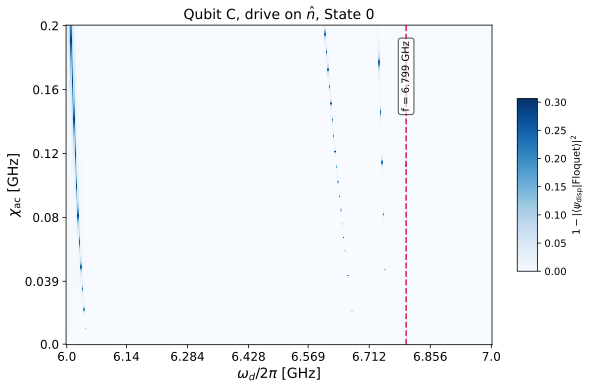

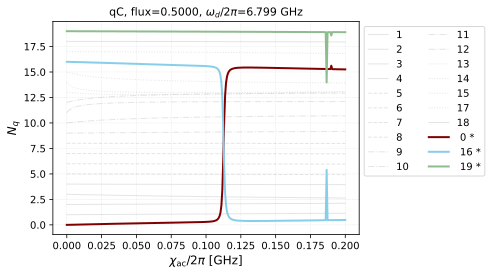

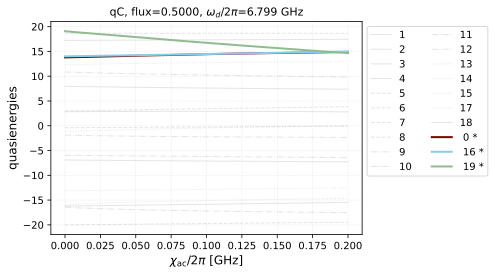

(<Figure size 700x400 with 1 Axes>,
 <Axes: title={'center': 'qC, flux=0.5000, $\\omega_d/2\\pi$=6.799 GHz'}, xlabel='$\\chi_{\\rm ac}/2\\pi$ [GHz]', ylabel='quasienergies'>)

In [326]:
results_qC["_metadata"] = {"flux_point": flux_point, "qubit_name": "C"}
plot_data = np.clip(1 - results_qC["displaced_state_overlaps"][:, :, 0].T, 0.0, 0.5)
omega_idx =  mark_plot_drive_scar_map(
    plot_data,
    omega_d_values_qC,
    chi_ac_values_qC,
    target_GHz= 6.8,
    state = 0
)
highlight_states = [0,16,19]
highlight_states_full = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19]
plot_branch_analysis_at_drive(
    results_qC,
    omega_d_values_qC,
    chi_ac_values_qC,
    omega_idx=omega_idx,
    max_curves=20,
    highlight_states=highlight_states,
    plot_quantity='avg_excitation',  
    gray_others=True,
    qubit_name="C")
plot_branch_analysis_at_drive(
    results_qC,
    omega_d_values_qC,
    chi_ac_values_qC,
    omega_idx=omega_idx,
    max_curves=20,
    highlight_states=highlight_states,
    plot_quantity='quasienergies',
    gray_others=True,
    qubit_name="C",
)